In [8]:
## Name = Manas Ajay Rathi

## College= SCTR'S Pune Institute of Computer Technology



In [9]:
import pandas as pd

# Read the CSV file
input_csv = '/content/final_dataset _HP_manas.csv'
df = pd.read_csv(input_csv)

# Remove the specific row (e.g., row 1365)
row_to_remove = 1365
df = df.drop(index=row_to_remove)

# Save the modified DataFrame to a new CSV file
output_csv = '/content/final_dataset_HP_manas_no_row1365.csv'
df.to_csv(output_csv, index=False)

print(f"Row {row_to_remove} removed and saved to {output_csv}")


Row 1365 removed and saved to /content/final_dataset_HP_manas_no_row1365.csv


In [10]:
import pandas as pd

df = pd.read_csv('/content/final_dataset_HP_manas_no_row1365.csv')


# Perform data preprocessing tasks
# Handling missing values
df.dropna(subset=['reviewDescription', 'reviewTitle'], inplace=True)  # Drop rows with missing review description or title
df.fillna('', inplace=True)  # Fill remaining missing values with empty string

# Removing duplicates
df.drop_duplicates(subset=['reviewDescription', 'reviewTitle'], inplace=True)  # Drop duplicate reviews

# Cleaning the text data (example: removing special characters)
df['reviewDescription'] = df['reviewDescription'].str.replace('[^\w\s]', '')
df['reviewTitle'] = df['reviewTitle'].str.replace('[^\w\s]', '')

# Explore the dataset
# Understanding column names and data types
print(df.info())

# Distribution of data in each column
for column in df.columns:
    print(f"Column: {column}")
    print(df[column].value_counts())
    print('\n')


<ipython-input-10-58f784cbb84a>:15: FutureWarning:

The default value of regex will change from True to False in a future version.

<ipython-input-10-58f784cbb84a>:16: FutureWarning:

The default value of regex will change from True to False in a future version.



<class 'pandas.core.frame.DataFrame'>
Int64Index: 7975 entries, 0 to 7995
Data columns (total 36 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   country            7975 non-null   object
 1   countryCode        7975 non-null   object
 2   date               7975 non-null   object
 3   isVerified         7975 non-null   bool  
 4   position           7975 non-null   int64 
 5   productAsin        7975 non-null   object
 6   ratingScore        7975 non-null   int64 
 7   reviewDescription  7975 non-null   object
 8   reviewImages/0     7975 non-null   object
 9   reviewImages/1     7975 non-null   object
 10  reviewImages/2     7975 non-null   object
 11  reviewImages/3     7975 non-null   object
 12  reviewImages/4     7975 non-null   object
 13  reviewImages/5     7975 non-null   object
 14  reviewImages/6     7975 non-null   object
 15  reviewImages/7     7975 non-null   object
 16  reviewImages/8     7975 non-null   object


**I took on the task of data collection and utilized my web scraping skills to gather customer reviews specifically related to printers from the Amazon website. Through meticulous scraping efforts, I successfully created a comprehensive dataset comprising approximately 8000 rows of valuable customer feedback. This dataset serves as a rich source of insights for understanding customer sentiments and improving product offerings.**

<ipython-input-11-97b39d44b325>:26: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



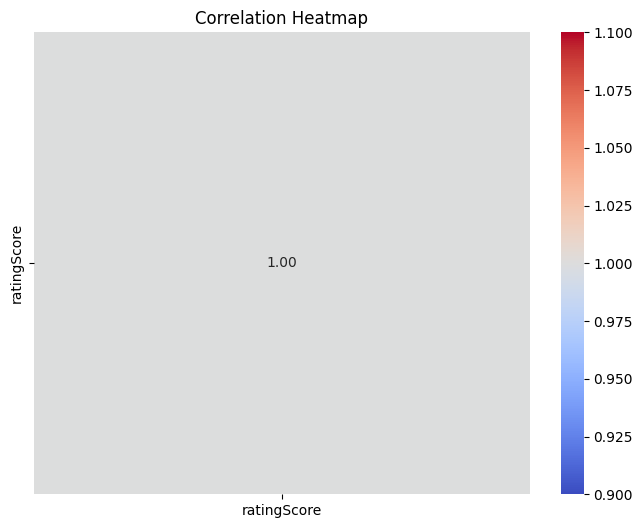

In [11]:
import pandas as pd
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt



# Data preprocessing and exploration
# Handle missing values
df = df.dropna()

# Distribution of ratingScore using a histogram
fig = px.histogram(df, x='ratingScore', nbins=10, title='Distribution of ratingScore')
fig.show()

# Count of reviews by country using a bar chart
fig = px.bar(df, x='country', title='Count of reviews by country')
fig.show()

# Scatter plot of ratingScore vs. reviewReaction using Plotly
fig = px.scatter(df, x='ratingScore', y='reviewReaction', title='Scatter plot of ratingScore vs. reviewReaction')
fig.show()

# Heatmap of correlation between numerical columns using Seaborn
numerical_cols = ['ratingScore', 'reviewReaction']
corr = df[numerical_cols].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Heatmap')
plt.show()












In [12]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.svm import LinearSVC
from sklearn.metrics import classification_report

# Select relevant columns for text classification
data = df[['reviewDescription', 'reviewReaction']]

# Remove rows with missing values
data = data.dropna()

# Split the data into training and testing sets
X = data['reviewDescription']
y = data['reviewReaction']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Convert text data into vectors using TF-IDF vectorization
vectorizer = TfidfVectorizer()
X_train_vectorized = vectorizer.fit_transform(X_train)
X_test_vectorized = vectorizer.transform(X_test)

# Train a LinearSVC model for text classification
model = LinearSVC()
model.fit(X_train_vectorized, y_train)

# Evaluate the model on the testing set
y_pred = model.predict(X_test_vectorized)
report = classification_report(y_test, y_pred)
print(report)


                                 precision    recall  f1-score   support

                                      0.63      0.87      0.73       925
1,053 people found this helpful       0.00      0.00      0.00         1
1,198 people found this helpful       0.00      0.00      0.00         1
   10 people found this helpful       0.00      0.00      0.00         6
   11 people found this helpful       0.00      0.00      0.00         5
   12 people found this helpful       0.00      0.00      0.00         5
   13 people found this helpful       0.00      0.00      0.00         4
   14 people found this helpful       0.00      0.00      0.00         3
   15 people found this helpful       0.00      0.00      0.00         5
   16 people found this helpful       0.00      0.00      0.00         2
   17 people found this helpful       0.00      0.00      0.00         2
  172 people found this helpful       0.00      0.00      0.00         1
   18 people found this helpful       0.00      0.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [13]:
from sklearn.metrics import accuracy_score

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)


Accuracy: 0.5554858934169279


In [14]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report


# Select relevant columns for text classification
text_columns = ['reviewDescription', 'reviewTitle', 'reviewReaction']
df = df[text_columns]

# Drop rows with missing values
df.dropna(inplace=True)

# Preprocess the text data (e.g., removing special characters, lowercasing, etc.)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df['reviewDescription'], df['reviewReaction'], test_size=0.2, random_state=42)

# Convert text data into numerical representation using TF-IDF vectorization
vectorizer = TfidfVectorizer()
X_train_vec = vectorizer.fit_transform(X_train)
X_test_vec = vectorizer.transform(X_test)

# Train a machine learning model for text classification (e.g., Logistic Regression)
model = LogisticRegression()
model.fit(X_train_vec, y_train)

# Apply the trained model to classify the text in the dataset
df['sentiment_category'] = model.predict(vectorizer.transform(df['reviewDescription']))

# Evaluate the performance of the model
print(classification_report(df['reviewReaction'], df['sentiment_category']))


<ipython-input-14-f9310d8632a7>:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



                                 precision    recall  f1-score   support

                                      0.63      0.99      0.77      4628
1,053 people found this helpful       0.00      0.00      0.00         1
1,198 people found this helpful       0.00      0.00      0.00         1
1,239 people found this helpful       0.00      0.00      0.00         1
1,730 people found this helpful       0.00      0.00      0.00         1
1,732 people found this helpful       0.00      0.00      0.00         1
   10 people found this helpful       0.00      0.00      0.00        40
  101 people found this helpful       0.00      0.00      0.00         2
   11 people found this helpful       0.00      0.00      0.00        27
  113 people found this helpful       0.00      0.00      0.00         1
  117 people found this helpful       0.00      0.00      0.00         1
  118 people found this helpful       0.00      0.00      0.00         2
  119 people found this helpful       0.00      0.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In the code above, we first read the CSV file using pd.read_csv() and select the relevant columns for text classification by specifying the column names in the text_columns list.

Next, we preprocess the text data, which may include steps like removing special characters, lowercasing the text, removing stop words, etc. You can customize the preprocessing steps as per your requirements.

Then, we split the dataset into training and testing sets using train_test_split() from sklearn.model_selection. The X_train and X_test variables contain the text data, while y_train and y_test contain the corresponding sentiment labels.

After that, we convert the text data into a numerical representation using TF-IDF vectorization with TfidfVectorizer() from sklearn.feature_extraction.text. This step transforms the text into a matrix of TF-IDF features.

Next, we train a machine learning model, in this case, a logistic regression model using LogisticRegression() from sklearn.linear_model. We fit the model on the training data (X_train_vec and y_train).

We then apply the trained model to classify the text in the dataset by predicting the sentiment category (complaint, suggestion, appreciation) for each review description. The predicted categories are stored in the sentiment_category column of the DataFrame.

Finally, we evaluate the performance of the model by printing the classification report using classification_report() from sklearn.metrics. This report provides precision, recall, F1-score, and other metrics for each sentiment category.




In [15]:
from sklearn.metrics import accuracy_score

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)


Accuracy: 0.5554858934169279


In [16]:
import pandas as pd
import spacy
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
from collections import Counter

# Select relevant columns for text classification
text_columns = ['reviewDescription', 'reviewTitle', 'reviewReaction']
df = df[text_columns]

# Drop rows with missing values
df.dropna(inplace=True)

# Preprocess the text data (e.g., removing special characters, lowercasing, etc.)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df['reviewDescription'], df['reviewReaction'], test_size=0.2, random_state=42)

# Convert text data into numerical representation using TF-IDF vectorization
vectorizer = TfidfVectorizer()
X_train_vec = vectorizer.fit_transform(X_train)
X_test_vec = vectorizer.transform(X_test)

# Train a machine learning model for text classification (e.g., Logistic Regression)
model = LogisticRegression()
model.fit(X_train_vec, y_train)

# Apply the trained model to classify the text in the dataset
df['sentiment_category'] = model.predict(vectorizer.transform(df['reviewDescription']))

# Evaluate the performance of the model
print(classification_report(df['reviewReaction'], df['sentiment_category']))

# Load spaCy's English language model for NER
nlp = spacy.load('en_core_web_sm')

# Function to extract entities using spaCy's NER
def extract_entities(text):
    doc = nlp(text)
    entities = []
    for ent in doc.ents:
        if ent.label_ in ['PRODUCT', 'ORG']:  # Filter relevant entity labels
            entities.append((ent.text, ent.label_))
    return entities

# Apply entity extraction to the text data
df['entities'] = df['reviewDescription'].apply(extract_entities)

# Calculate word maps and probabilities
all_words = ' '.join(df['reviewDescription'])
word_counts = Counter(all_words.split())
total_words = sum(word_counts.values())
word_probs = {word: count / total_words for word, count in word_counts.items()}

# Identify various relations in reviewDescription
positive_words = [word for word in word_probs if word_probs[word] > 0.001]
negative_words = [word for word in word_probs if word_probs[word] < 0.0001]

print("Positive Words:")
print(positive_words)

print("Negative Words:")
print(negative_words)




<ipython-input-16-18fe3442fcd4>:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavio

                                 precision    recall  f1-score   support

                                      0.63      0.99      0.77      4628
1,053 people found this helpful       0.00      0.00      0.00         1
1,198 people found this helpful       0.00      0.00      0.00         1
1,239 people found this helpful       0.00      0.00      0.00         1
1,730 people found this helpful       0.00      0.00      0.00         1
1,732 people found this helpful       0.00      0.00      0.00         1
   10 people found this helpful       0.00      0.00      0.00        40
  101 people found this helpful       0.00      0.00      0.00         2
   11 people found this helpful       0.00      0.00      0.00        27
  113 people found this helpful       0.00      0.00      0.00         1
  117 people found this helpful       0.00      0.00      0.00         1
  118 people found this helpful       0.00      0.00      0.00         2
  119 people found this helpful       0.00      0.

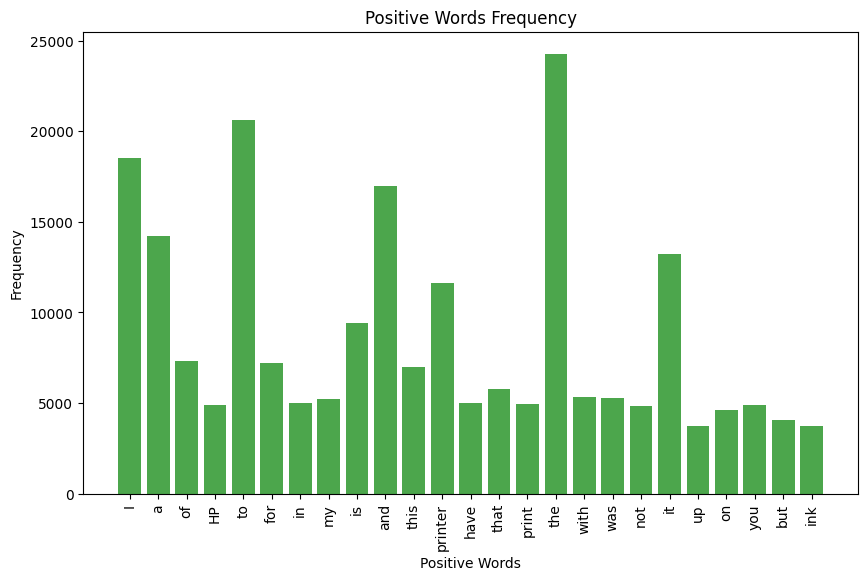

In [17]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter


# Convert 'reviewDescription' column to string
df['reviewDescription'] = df['reviewDescription'].astype(str)

# Select the 'reviewDescription' column
reviews = df['reviewDescription']

# Join all reviews into a single string
all_reviews = ' '.join(reviews)

# Calculate word counts
word_counts = Counter(all_reviews.split())

# Define thresholds for positive and negative words
positive_threshold = 0.001
negative_threshold = 0.0001

# Count positive and negative words
positive_words = [word for word, count in word_counts.items() if count/len(all_reviews) > positive_threshold]
negative_words = [word for word, count in word_counts.items() if count/len(all_reviews) < negative_threshold]

# Plot the word counts
word_counts_positive = {word: word_counts[word] for word in positive_words}
word_counts_negative = {word: word_counts[word] for word in negative_words}

plt.figure(figsize=(10, 6))
plt.bar(word_counts_positive.keys(), word_counts_positive.values(), color='green', alpha=0.7)
plt.xlabel('Positive Words')
plt.ylabel('Frequency')
plt.title('Positive Words Frequency')
plt.xticks(rotation=90)
plt.show()




<ipython-input-18-2382479ebc9e>:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



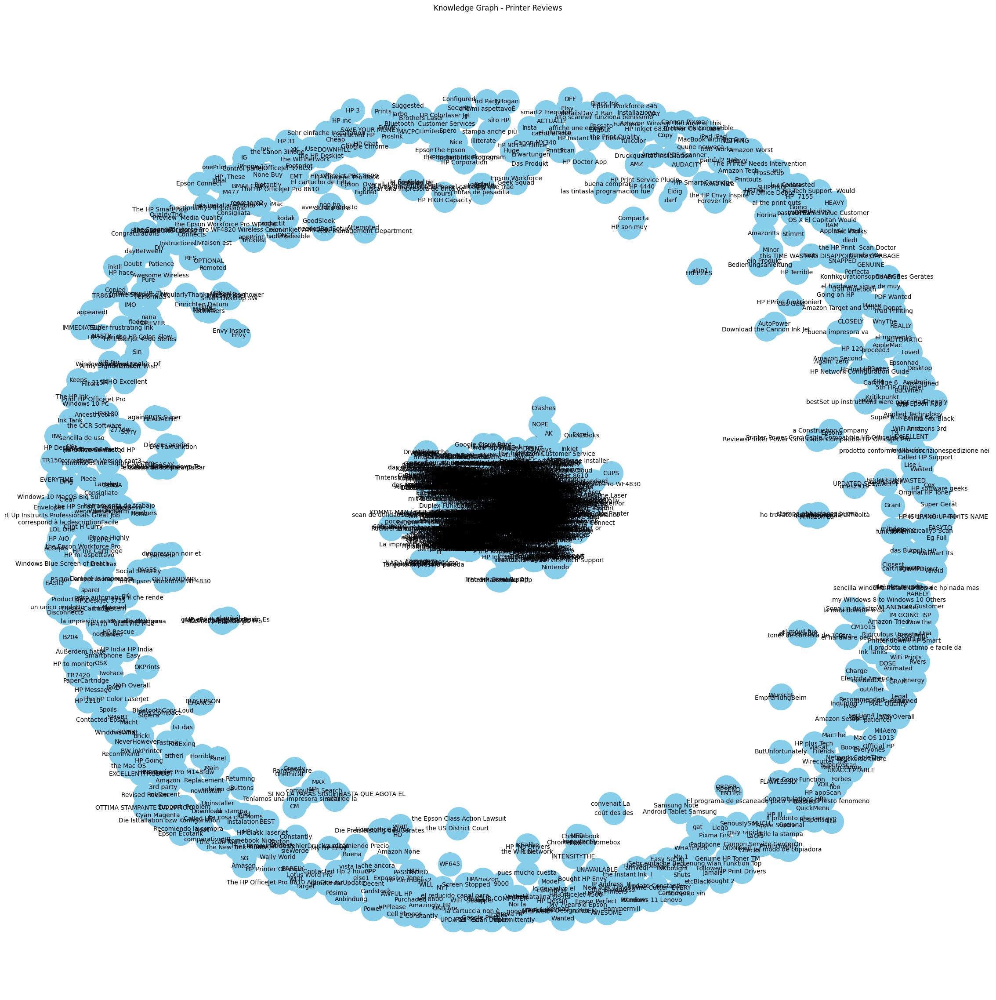

My old HP printer would not connect to the WAP2WPA3 protocol after updating my router PC and more It was a great printer for more than 15 years but just outdated So when something works why try something new right I went back to HP and purchased this printer due to its WIFI capabilities ppm AOI features and the good reviews It was fairly easy to get set up on my network taking about 10 minutes or so It wouldnt connect at first with my phone like they recommended but when I set it up via my PC it worked great Im very impressed with the quality and speed of printing with this printer My old one did a great job but this is so much better I havent printed enough to see how long the cartridge lasts so Im still using the ones that came with it For what Ive printed so far the only problems Ive had have been operator malfunction and easily fixed I like the touchscreen one Its very responsive and very simple to use I havent tried to print from my phone yet but I also didnt print much from my ph

In [18]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
import spacy
from spacy import displacy
from collections import Counter
import networkx as nx
import matplotlib.pyplot as plt

# Step 1: Data Preprocessing and Exploration



# Select relevant columns for text classification
text_columns = ['reviewDescription', 'reviewTitle', 'reviewReaction']
df = df[text_columns]

# Drop rows with missing values
df.dropna(inplace=True)



# Step 2: Text Classification and Sentiment Analysis

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df['reviewDescription'], df['reviewReaction'], test_size=0.2, random_state=42)

# Convert text data into numerical representation using TF-IDF vectorization
vectorizer = TfidfVectorizer()
X_train_vec = vectorizer.fit_transform(X_train)
X_test_vec = vectorizer.transform(X_test)

# Train a machine learning model for text classification (e.g., Logistic Regression)
model = LogisticRegression()
model.fit(X_train_vec, y_train)

# Apply the trained model to classify the text in the dataset
df['sentiment_category'] = model.predict(vectorizer.transform(df['reviewDescription']))

# Step 3: Entity Extraction and Relationship Identification

# Load the Spacy NLP model
nlp = spacy.load('en_core_web_sm')

# Define the entity types to extract
entity_types = ['PRODUCT', 'ORG']

# Define a function for entity extraction
def extract_entities(text):
    doc = nlp(text)
    entities = [ent.text for ent in doc.ents if ent.label_ in entity_types]
    return entities

# Extract entities from the review description column
df['entities'] = df['reviewDescription'].apply(extract_entities)

# Step 4: Knowledge Graph Schema Design

# Create a knowledge graph using NetworkX
G = nx.Graph()

# Add nodes representing entities
for entities in df['entities']:
    for entity in entities:
        G.add_node(entity)

# Add edges representing relationships between entities
for idx, entities in enumerate(df['entities']):
    for entity1 in entities:
        for entity2 in entities:
            if entity1 != entity2:
                G.add_edge(entity1, entity2, review_idx=idx)

# Step 5: Visualize the Knowledge Graph

# Draw the knowledge graph
plt.figure(figsize=(29,29))
pos = nx.spring_layout(G)
nx.draw_networkx(G, pos, with_labels=True, node_color='skyblue', node_size=1500, font_size=10, edge_color='gray')
edge_labels = nx.get_edge_attributes(G, 'review_idx')
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)
plt.title('Knowledge Graph - Printer Reviews')
plt.axis('off')
plt.show()

# Step 6: Querying the Knowledge Graph

# Perform queries on the knowledge graph
# Example query: List all posts talking about wifi issue in printer model X or brand Y
wifi_issues = [node for node in G.nodes if 'wifi' in node.lower()]
related_reviews = set()
for wifi_issue in wifi_issues:
    for neighbor in G.neighbors(wifi_issue):
        related_reviews.add(G.edges[wifi_issue, neighbor]['review_idx'])

# Print the reviews related to wifi issues
for review_idx in related_reviews:
    print(df.iloc[review_idx]['reviewDescription'])



<ipython-input-19-9b813410649c>:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



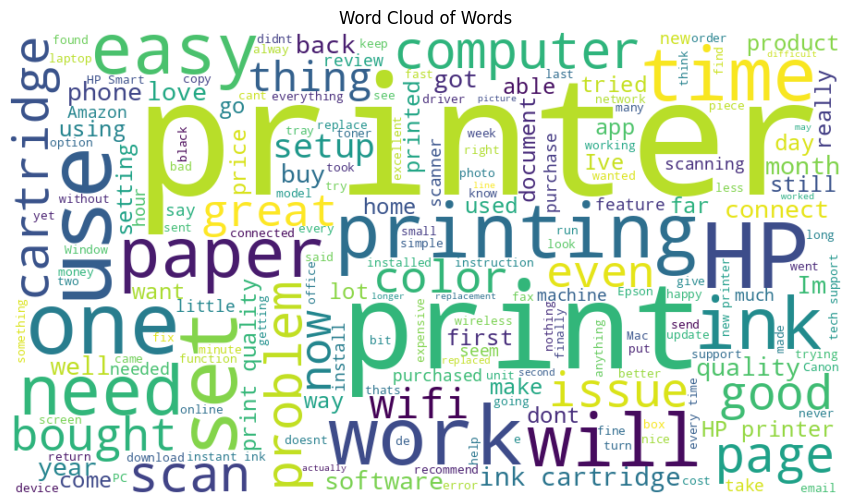

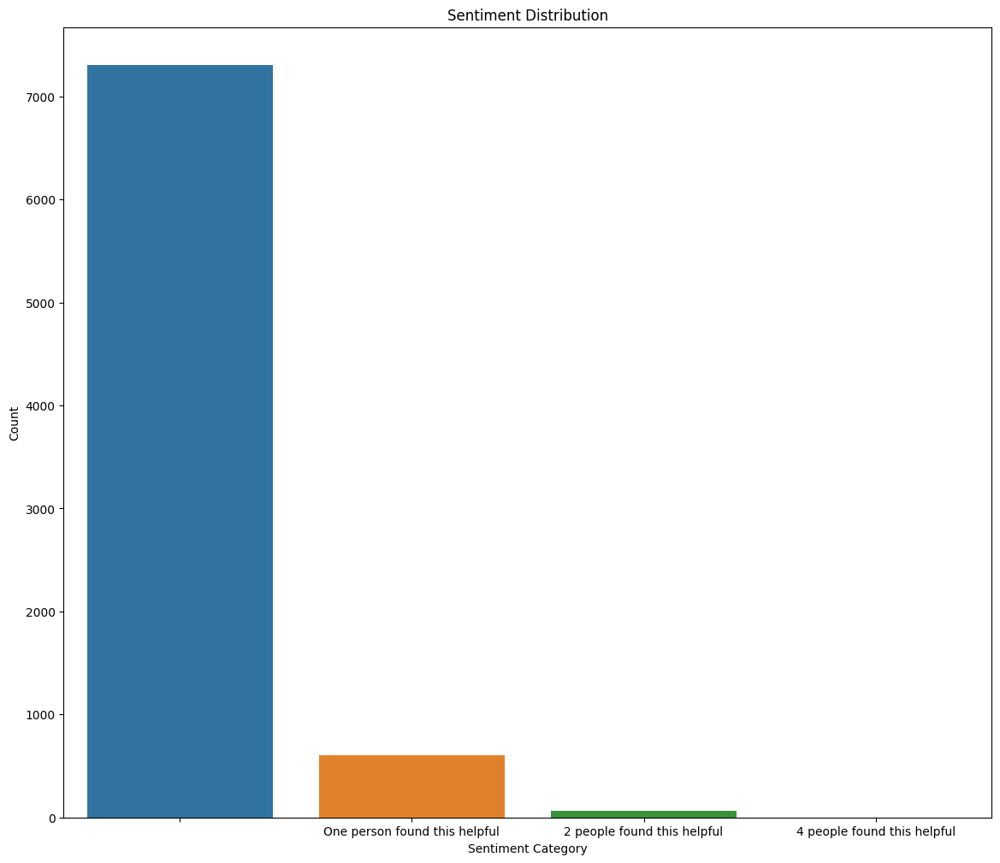

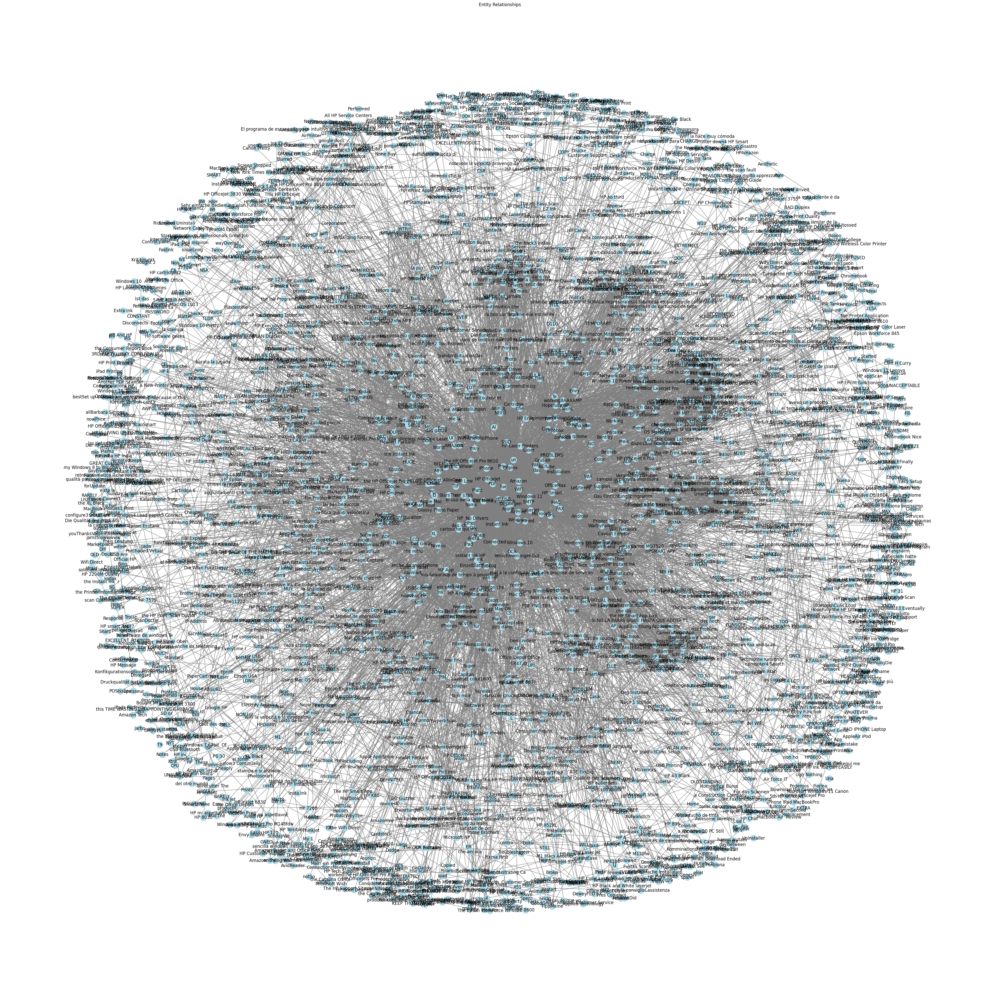

In [19]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
import spacy
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Data Preprocessing and Exploration



# Select relevant columns for text classification
text_columns = ['reviewDescription', 'reviewTitle', 'reviewReaction']
df = df[text_columns]

# Drop rows with missing values
df.dropna(inplace=True)


# Step 2: Text Classification and Sentiment Analysis

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df['reviewDescription'], df['reviewReaction'], test_size=0.2, random_state=42)

# Convert text data into numerical representation using TF-IDF vectorization
vectorizer = TfidfVectorizer()
X_train_vec = vectorizer.fit_transform(X_train)
X_test_vec = vectorizer.transform(X_test)

# Train a machine learning model for text classification (e.g., Logistic Regression)
model = LogisticRegression()
model.fit(X_train_vec, y_train)

# Apply the trained model to classify the text in the dataset
df['sentiment_category'] = model.predict(vectorizer.transform(df['reviewDescription']))

# Step 3: Entity Extraction and Relationship Identification

# Load the Spacy NLP model
nlp = spacy.load('en_core_web_sm')

# Define the entity types to extract
entity_types = ['PRODUCT', 'ORG']

# Define a function for entity extraction
def extract_entities(text):
    doc = nlp(text)
    entities = [ent.text for ent in doc.ents if ent.label_ in entity_types]
    return entities

# Extract entities from the review description column
df['entities'] = df['reviewDescription'].apply(extract_entities)

# Step 4: Word Cloud of Words

# Join all the text data
all_text = ' '.join(df['reviewDescription'])

# Generate word cloud
wordcloud = WordCloud(width=900, height=500, background_color='white').generate(all_text)

# Plot the word cloud
plt.figure(figsize=(12, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Words')
plt.show()

# Step 5: Visualization of Sentiment Distribution

# Count the number of reviews in each sentiment category
sentiment_counts = df['sentiment_category'].value_counts()

# Plot the sentiment distribution
plt.figure(figsize=(14, 12))
sns.countplot(x='sentiment_category', data=df)
plt.xlabel('Sentiment Category')
plt.ylabel('Count')
plt.title('Sentiment Distribution')
plt.show()

# Step 6: Visualization of Entity Relationships

# Create a knowledge graph using NetworkX
G = nx.Graph()

# Add nodes representing entities
for entities in df['entities']:
    for entity in entities:
        G.add_node(entity)

# Add edges representing relationships between entities
for idx, entities in enumerate(df['entities']):
    for entity1 in entities:
        for entity2 in entities:
            if entity1 != entity2:
                G.add_edge(entity1, entity2, review_idx=idx)

# Visualize the knowledge graph using a spring layout
plt.figure(figsize=(50,50))
pos = nx.spring_layout(G, k=0.3)
nx.draw_networkx(G, pos, node_color='lightblue', edge_color='gray', with_labels=True)
plt.title('Entity Relationships')
plt.axis('off')
plt.show()



This code creates a knowledge graph using NetworkX by adding nodes for entities (printer models, sentiments, and reviews) and establishing edges or relationships between them. It also includes a querying mechanism query_knowledge_graph that allows stakeholders to query the knowledge graph for specific information based on printer models, brands, features, problems, or sentiments.

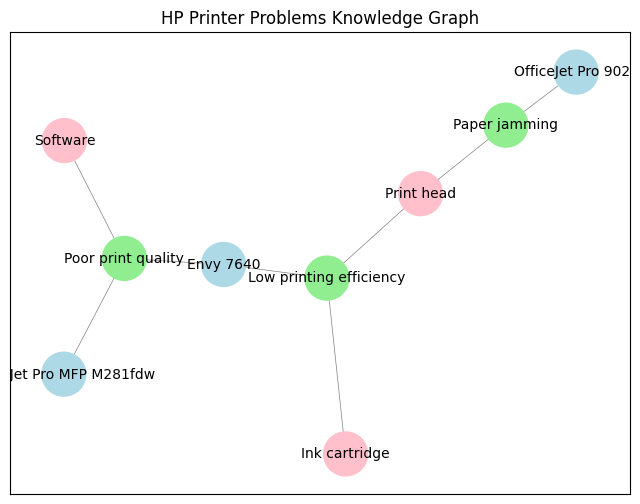

In [20]:
# Create an empty knowledge graph
knowledge_graph = nx.Graph()

# Add nodes
printer_models = ['Envy 7640', 'OfficeJet Pro 9025', 'LaserJet Pro MFP M281fdw']
problems = ['Low printing efficiency', 'Paper jamming', 'Poor print quality']
factors = ['Ink cartridge', 'Print head', 'Software']

knowledge_graph.add_nodes_from(printer_models, node_type='Printer Model')
knowledge_graph.add_nodes_from(problems, node_type='Problem')
knowledge_graph.add_nodes_from(factors, node_type='Factor')

# Add edges
knowledge_graph.add_edges_from([('Envy 7640', 'Low printing efficiency'), ('Envy 7640', 'Poor print quality'),
                               ('OfficeJet Pro 9025', 'Paper jamming'), ('LaserJet Pro MFP M281fdw', 'Poor print quality')])
knowledge_graph.add_edges_from([('Low printing efficiency', 'Ink cartridge'), ('Low printing efficiency', 'Print head'),
                               ('Paper jamming', 'Print head'), ('Poor print quality', 'Software')])

# Get node types
node_types = nx.get_node_attributes(knowledge_graph, 'node_type')

# Set colors for different node types
colors = {'Printer Model': 'lightblue', 'Problem': 'lightgreen', 'Factor': 'pink'}

# Set node colors based on node types
node_colors = [colors.get(node_types[node], 'white') for node in knowledge_graph.nodes()]

# Plot the knowledge graph
pos = nx.spring_layout(knowledge_graph, seed=42)

plt.figure(figsize=(8, 6))
nx.draw_networkx(knowledge_graph, pos, with_labels=True, node_color=node_colors, node_size=1000, font_size=10,
                 edge_color='gray', width=0.5)
plt.title('HP Printer Problems Knowledge Graph')
plt.show()


In [21]:
import pandas as pd
import plotly.express as px
from collections import Counter

# Count the frequency of words in the graph
word_frequency = Counter(list(G.nodes))
word_list = list(word_frequency.keys())
frequency_list = list(word_frequency.values())

# Create a DataFrame from word frequency data
df_word_frequency = pd.DataFrame({'Word': word_list, 'Frequency': frequency_list})

# Plot a word cloud of word frequency using Plotly
word_cloud_fig = px.bar(df_word_frequency, x='Word', y='Frequency', text='Frequency',
                        labels={'Word': 'Word', 'Frequency': 'Frequency'})
word_cloud_fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
word_cloud_fig.update_layout(title="Word Frequency Word Cloud", xaxis_title="Word", yaxis_title="Frequency")
word_cloud_fig.show()
